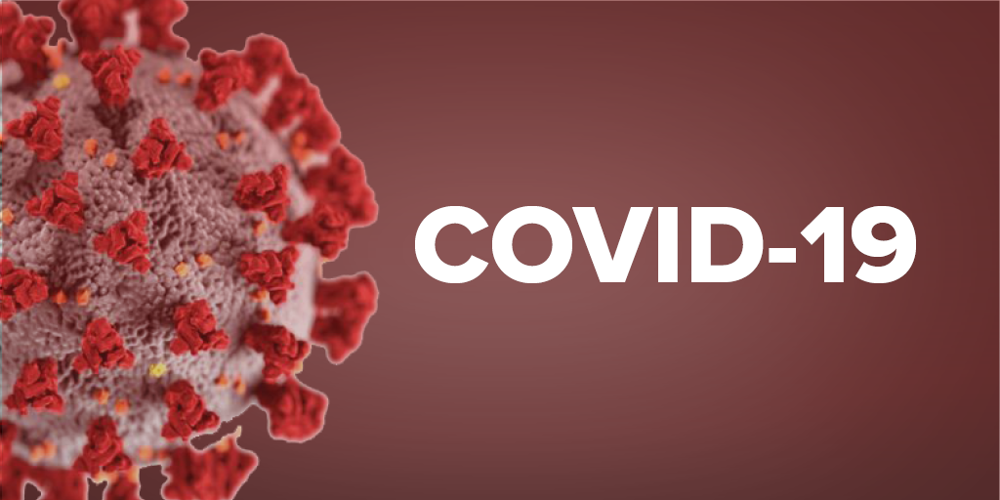

## Table of Contents

1. [Problem Statement](#section1)<br>
    - 1.1 [Introduction](#section101)<br/>
    - 1.2 [Data source and data set](#section102)<br/>
2. [Load the Packages and Data](#section2)
3. [Data Profiling](#section3)
    - 3.1 [Understanding the Dataset](#section301)<br/>
    - 3.2 [Pre Profiling](#section302)<br/>
    - 3.3 [Preprocessing](#section303)
    - 3.4 [Post Profiling](#section304)
4. [Question](#section4)
    - 4.1 [Top 10 Countries with highest number of Total Confirmed Cases.](#section401)
    - 4.2 [Top 10 Countries with highest number of Serious Critical Cases.](#section402)
    - 4.3 [ Top 10 countries with Total Covid-19 Deaths.](#section403)
    - 4.4 [Total Recovered Cases Vs Active Cases Vs Total Death Cases.](#section404)
    - 4.5 [ Types of Vaccines in use](#section405)
    - 4.6 [ Which Set of Vaccines are preferred by which Country?](#section406)
    - 4.7 [What is the Trend of Vaccinations Country Wise?](#section407)
    - 4.8 [What is the Scenario of Active Cases with Daily Vaccinations ?](#section408)
    - 4.9 [What is Country Wise Positive Rate?](#section409)
    - 4.10 [What are the relative Stats of People Vaccinated and People Completely Vaccinated?](#section4010)
    - 4.11 [Which country has vaccinated a larger percent from its population? ](#section4011)
   

[__Introduction__](section)

[This is an Exploratory Data Analysis project on Covid-19 Cases and Vaccination.
The Aim of the Project is to extract the characteristic results from the Data set and conduct
comparative analysis of cases and vaccination among the countries.
The essential Questions formulated are related to Set of Vaccines are preferred by Countries,
daily vaccinations, positive rate, total confirmed, active and death cases. There are several
Visualizations regarding Leading Countries in highest number of total confirmed cases,
serious critical cases and total Covid-19 deaths](section)

### 2. [Load the Packages and Data](#section2)

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from pandas_profiling import ProfileReport
import datetime as dt

### [Loading DataSet](#section)



In [2]:
Corona_Virus=pd.read_csv("D:\\GitHub\\Covid-19_Exploratory-Data-Analysis\\00.Resources\\CoronaVirus_Dataset\\worldometer_coronavirus_daily_data.csv")
Corona_Virus_Summary=pd.read_csv("D:\\GitHub\\Covid-19_Exploratory-Data-Analysis\\00.Resources\\CoronaVirus_Dataset\\worldometer_coronavirus_summary_data.csv")
Vaccinations=pd.read_csv("D:\\GitHub\\Covid-19_Exploratory-Data-Analysis\\00.Resources\\Vaccinations_Dataset\\country_vaccinations.csv")

# 3. [Data Profiling](#section3)



## 3.1 [Understanding the Dataset](#section3)

In [3]:
print('World Covid-19 Dataset')
print('Rows : ',Corona_Virus.shape[0])
print("Columns: ",Corona_Virus.shape[1])
print("Total Size: ",Corona_Virus.size)

World Covid-19 Dataset
Rows :  184787
Columns:  7
Total Size:  1293509


CoronaVirus Data set has __184787 rows__ , __7 columns__ and __Total Size is 1293509__

In [4]:
Corona_Virus.columns

Index(['date', 'country', 'cumulative_total_cases', 'daily_new_cases',
       'active_cases', 'cumulative_total_deaths', 'daily_new_deaths'],
      dtype='object')

In [5]:
Corona_Virus.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 184787 entries, 0 to 184786
Data columns (total 7 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   date                     184787 non-null  object 
 1   country                  184787 non-null  object 
 2   cumulative_total_cases   184787 non-null  float64
 3   daily_new_cases          174329 non-null  float64
 4   active_cases             166747 non-null  float64
 5   cumulative_total_deaths  178227 non-null  float64
 6   daily_new_deaths         157850 non-null  float64
dtypes: float64(5), object(2)
memory usage: 9.9+ MB


In [6]:
Corona_Virus

,date,country,cumulative_total_cases,daily_new_cases,active_cases,cumulative_total_deaths,daily_new_deaths
0,2020-2-15,Afghanistan,0.0,NaN,0.0,0.0,NaN
1,2020-2-16,Afghanistan,0.0,NaN,0.0,0.0,NaN
2,2020-2-17,Afghanistan,0.0,NaN,0.0,0.0,NaN
3,2020-2-18,Afghanistan,0.0,NaN,0.0,0.0,NaN
4,2020-2-19,Afghanistan,0.0,NaN,0.0,0.0,NaN
...,...,...,...,...,...,...,...
184782,2022-5-10,Zimbabwe,248642.0,106.0,963.0,5481.0,2.0
184783,2022-5-11,Zimbabwe,248778.0,136.0,1039.0,5481.0,0.0
184784,2022-5-12,Zimbabwe,248943.0,165.0,1158.0,5481.0,0.0
184785,2022-5-13,Zimbabwe,249131.0,188.0,1283.0,5482.0,1.0


In [7]:
Corona_Virus.corr()

C:\Users\praka\AppData\Local\Temp\ipykernel_14456\2494307235.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  Corona_Virus.corr()


,cumulative_total_cases,daily_new_cases,active_cases,cumulative_total_deaths,daily_new_deaths
cumulative_total_cases,1.000000,0.568780,0.679464,0.913416,0.516627
daily_new_cases,0.568780,1.000000,0.810888,0.499613,0.595341
active_cases,0.679464,0.810888,1.000000,0.609694,0.627365
cumulative_total_deaths,0.913416,0.499613,0.609694,1.000000,0.586202
daily_new_deaths,0.516627,0.595341,0.627365,0.586202,1.000000


In [8]:
print('World Covid-19 Summary Dataset')
print('Rows : ',Corona_Virus_Summary.shape[0])
print("Columns: ",Corona_Virus_Summary.shape[1])
print("Total Size: ",Corona_Virus_Summary.size)

World Covid-19 Summary Dataset
Rows :  226
Columns:  12
Total Size:  2712


In [9]:
Corona_Virus_Summary.columns

Index(['country', 'continent', 'total_confirmed', 'total_deaths',
       'total_recovered', 'active_cases', 'serious_or_critical',
       'total_cases_per_1m_population', 'total_deaths_per_1m_population',
       'total_tests', 'total_tests_per_1m_population', 'population'],
      dtype='object')

In [10]:
Corona_Virus_Summary.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 226 entries, 0 to 225
Data columns (total 12 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   country                         226 non-null    object 
 1   continent                       226 non-null    object 
 2   total_confirmed                 226 non-null    int64  
 3   total_deaths                    218 non-null    float64
 4   total_recovered                 204 non-null    float64
 5   active_cases                    204 non-null    float64
 6   serious_or_critical             145 non-null    float64
 7   total_cases_per_1m_population   226 non-null    int64  
 8   total_deaths_per_1m_population  218 non-null    float64
 9   total_tests                     212 non-null    float64
 10  total_tests_per_1m_population   212 non-null    float64
 11  population                      226 non-null    int64  
dtypes: float64(7), int64(3), object(2)
m

In [11]:
Corona_Virus_Summary.corr()

C:\Users\praka\AppData\Local\Temp\ipykernel_14456\1167846827.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  Corona_Virus_Summary.corr()


,total_confirmed,total_deaths,total_recovered,active_cases,serious_or_critical,total_cases_per_1m_population,total_deaths_per_1m_population,total_tests,total_tests_per_1m_population,population
total_confirmed,1.000000,0.905518,0.999800,0.730294,0.467644,0.132850,0.210908,0.878797,0.057582,0.420253
total_deaths,0.905518,1.000000,0.921612,0.585256,0.678045,0.022260,0.284079,0.775164,-0.010050,0.425389
total_recovered,0.999800,0.921612,1.000000,0.716899,0.468261,0.130081,0.234269,0.891476,0.066926,0.427036
active_cases,0.730294,0.585256,0.716899,1.000000,0.307591,0.141796,0.180904,0.560716,0.055022,0.130200
serious_or_critical,0.467644,0.678045,0.468261,0.307591,1.000000,-0.084683,0.154609,0.235215,-0.090568,0.222699
total_cases_per_1m_population,0.132850,0.022260,0.130081,0.141796,-0.084683,1.000000,0.475843,0.099096,0.609078,-0.133743
total_deaths_per_1m_population,0.210908,0.284079,0.234269,0.180904,0.154609,0.475843,1.000000,0.147738,0.193845,-0.076711
total_tests,0.878797,0.775164,0.891476,0.560716,0.235215,0.099096,0.147738,1.000000,0.205150,0.546679
total_tests_per_1m_population,0.057582,-0.010050,0.066926,0.055022,-0.090568,0.609078,0.193845,0.205150,1.000000,-0.088400
population,0.420253,0.425389,0.427036,0.130200,0.222699,-0.133743,-0.076711,0.546679,-0.088400,1.000000


In [13]:
print('Covid-19 Vaccinations Dataset')
print('Rows : ',Vaccinations.shape[0])
print("Columns: ",Vaccinations.shape[1])
print("Total Size: ",Vaccinations.size)

Covid-19 Vaccinations Dataset
Rows :  86512
Columns:  15
Total Size:  1297680


Vaccinations Dataset has __86512 rows__ ,  __15 columns__  and __Total Size is 1297680__

In [14]:
Vaccinations

,country,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,vaccines,source_name,source_website
0,Afghanistan,AFG,2021-02-22,0.0,0.0,NaN,NaN,NaN,0.00,0.00,NaN,NaN,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://covid19.who.int/
1,Afghanistan,AFG,2021-02-23,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,34.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://covid19.who.int/
2,Afghanistan,AFG,2021-02-24,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,34.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://covid19.who.int/
3,Afghanistan,AFG,2021-02-25,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,34.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://covid19.who.int/
4,Afghanistan,AFG,2021-02-26,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,34.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://covid19.who.int/
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
86507,Zimbabwe,ZWE,2022-03-25,8691642.0,4814582.0,3473523.0,139213.0,69579.0,57.59,31.90,23.02,4610.0,"Oxford/AstraZeneca, Sinopharm/Beijing, Sinovac...",Ministry of Health,https://www.arcgis.com/home/webmap/viewer.html...
86508,Zimbabwe,ZWE,2022-03-26,8791728.0,4886242.0,3487962.0,100086.0,83429.0,58.25,32.38,23.11,5528.0,"Oxford/AstraZeneca, Sinopharm/Beijing, Sinovac...",Ministry of Health,https://www.arcgis.com/home/webmap/viewer.html...
86509,Zimbabwe,ZWE,2022-03-27,8845039.0,4918147.0,3493763.0,53311.0,90629.0,58.61,32.59,23.15,6005.0,"Oxford/AstraZeneca, Sinopharm/Beijing, Sinovac...",Ministry of Health,https://www.arcgis.com/home/webmap/viewer.html...
86510,Zimbabwe,ZWE,2022-03-28,8934360.0,4975433.0,3501493.0,89321.0,100614.0,59.20,32.97,23.20,6667.0,"Oxford/AstraZeneca, Sinopharm/Beijing, Sinovac...",Ministry of Health,https://www.arcgis.com/home/webmap/viewer.html...


In [15]:
Corona_Virus.describe()

,cumulative_total_cases,daily_new_cases,active_cases,cumulative_total_deaths,daily_new_deaths
count,1.847870e+05,174329.000000,1.667470e+05,1.782270e+05,157850.000000
mean,7.251089e+05,2987.633285,6.239283e+04,1.388600e+04,39.831834
std,3.681471e+06,17803.232663,3.955641e+05,6.049521e+04,181.102770
min,0.000000e+00,-322.000000,-1.432100e+04,0.000000e+00,-39.000000
25%,1.099000e+03,0.000000,6.000000e+01,2.400000e+01,0.000000
50%,1.775600e+04,58.000000,1.386000e+03,3.040000e+02,1.000000
75%,2.238085e+05,728.000000,1.462050e+04,4.111000e+03,12.000000
max,8.420947e+07,909610.000000,1.793543e+07,1.026646e+06,5093.000000


In [16]:
Vaccinations.describe()

,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million
count,4.360700e+04,4.129400e+04,3.880200e+04,3.536200e+04,8.621300e+04,43607.000000,41294.000000,38802.000000,86213.000000
mean,4.592964e+07,1.770508e+07,1.413830e+07,2.705996e+05,1.313055e+05,80.188543,40.927317,35.523243,3257.049157
std,2.246004e+08,7.078731e+07,5.713920e+07,1.212427e+06,7.682388e+05,67.913577,29.290759,28.376252,3934.312440
min,0.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000
25%,5.264100e+05,3.494642e+05,2.439622e+05,4.668000e+03,9.000000e+02,16.050000,11.370000,7.020000,636.000000
50%,3.590096e+06,2.187310e+06,1.722140e+06,2.530900e+04,7.343000e+03,67.520000,41.435000,31.750000,2050.000000
75%,1.701230e+07,9.152520e+06,7.559870e+06,1.234925e+05,4.409800e+04,132.735000,67.910000,62.080000,4682.000000
max,3.263129e+09,1.275541e+09,1.240777e+09,2.474100e+07,2.242429e+07,345.370000,124.760000,122.370000,117497.000000


In [17]:
Vaccinations.corr()

C:\Users\praka\AppData\Local\Temp\ipykernel_14456\3158765839.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  Vaccinations.corr()


,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million
total_vaccinations,1.000000,0.983438,0.989681,0.654712,0.688502,0.172297,0.184649,0.142252,0.038298
people_vaccinated,0.983438,1.000000,0.957599,0.755540,0.833433,0.123938,0.157775,0.101717,0.028720
people_fully_vaccinated,0.989681,0.957599,1.000000,0.647574,0.709768,0.159026,0.186369,0.158283,0.013220
daily_vaccinations_raw,0.654712,0.755540,0.647574,1.000000,0.965517,0.029329,0.042445,-0.027885,0.131078
daily_vaccinations,0.688502,0.833433,0.709768,0.965517,1.000000,0.042227,0.062566,-0.014055,0.133822
total_vaccinations_per_hundred,0.172297,0.123938,0.159026,0.029329,0.042227,1.000000,0.965329,0.975455,0.184609
people_vaccinated_per_hundred,0.184649,0.157775,0.186369,0.042445,0.062566,0.965329,1.000000,0.964167,0.276556
people_fully_vaccinated_per_hundred,0.142252,0.101717,0.158283,-0.027885,-0.014055,0.975455,0.964167,1.000000,0.109294
daily_vaccinations_per_million,0.038298,0.028720,0.013220,0.131078,0.133822,0.184609,0.276556,0.109294,1.000000


### 3.2 [Pre Profiling](#section302)<br/>

Now performing Pandas Profiling to understand Data better

In [18]:
Corona_virus_preProfiling=ProfileReport(Corona_Virus)

In [19]:
Corona_virus_preProfiling.to_file(output_file="Corona_Virus_preProfiling.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [20]:
Corona_virus_preProfiling

In [21]:
Corona_Virus_Summary_preProfiling=ProfileReport(Corona_Virus_Summary)

In [22]:
Corona_Virus_Summary_preProfiling.to_file(output_file="Corona_Virus_Summary_preProfiling.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [23]:
Corona_Virus_Summary_preProfiling

In [24]:
Vaccinations_preProfiling=ProfileReport(Vaccinations)

In [25]:
Vaccinations_preProfiling.to_file(output_file="Vaccinations_preProfiling.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [26]:
Vaccinations_preProfiling

### 3.3 [Preprocessing](#section303)

In [27]:
Co_Missing_Value=Corona_Virus.isnull().sum()
Co_Missing_Value_percentage=(Corona_Virus.isnull().sum()/len(Corona_Virus))*100
Co_Missing_data=pd.concat([Co_Missing_Value,Co_Missing_Value_percentage],axis=1,keys=['Total',"%"])
print(Co_Missing_data)


                         Total          %
date                         0   0.000000
country                      0   0.000000
cumulative_total_cases       0   0.000000
daily_new_cases          10458   5.659489
active_cases             18040   9.762592
cumulative_total_deaths   6560   3.550033
daily_new_deaths         26937  14.577324


In [28]:
Corona_Virus["daily_new_cases"].fillna(0,inplace=True)
Corona_Virus["active_cases"].fillna(0,inplace=True)
Corona_Virus["cumulative_total_deaths"].fillna(0,inplace=True)
Corona_Virus["daily_new_deaths"].fillna(0,inplace=True)

Filling the __NAN__ value with __0__ of table  **Corona_Virus**

In [29]:
Corona_Virus.isnull().sum()

date                       0
country                    0
cumulative_total_cases     0
daily_new_cases            0
active_cases               0
cumulative_total_deaths    0
daily_new_deaths           0
dtype: int64

In [12]:
positive_rate=Corona_Virus_Summary.total_confirmed/Corona_Virus_Summary.total_tests*100
Corona_Virus_Summary["positive_rate"]=positive_rate

In [30]:
Corona_Virus_Summary.isnull().sum()

country                            0
continent                          0
total_confirmed                    0
total_deaths                       8
total_recovered                   22
active_cases                      22
serious_or_critical               81
total_cases_per_1m_population      0
total_deaths_per_1m_population     8
total_tests                       14
total_tests_per_1m_population     14
population                         0
positive_rate                     14
dtype: int64

In [31]:
Corona_Virus_Summary["total_recovered"].fillna(0,inplace=True)
Corona_Virus_Summary["total_deaths"].fillna(0,inplace=True)
Corona_Virus_Summary["active_cases"].fillna(0,inplace=True)
Corona_Virus_Summary["serious_or_critical"].fillna(0,inplace=True)
Corona_Virus_Summary["total_deaths_per_1m_population"].fillna(0,inplace=True)
Corona_Virus_Summary["total_tests"].fillna(0,inplace=True)
Corona_Virus_Summary["positive_rate"].fillna(0,inplace=True)
Corona_Virus_Summary["total_tests_per_1m_population"].fillna(0,inplace=True)

In [32]:
Corona_Virus_Summary.isnull().sum()

country                           0
continent                         0
total_confirmed                   0
total_deaths                      0
total_recovered                   0
active_cases                      0
serious_or_critical               0
total_cases_per_1m_population     0
total_deaths_per_1m_population    0
total_tests                       0
total_tests_per_1m_population     0
population                        0
positive_rate                     0
dtype: int64

filling **NAN** value with **0** of  table **Corona_Virus_Summary**

In [33]:
Vac_missing_value=Vaccinations.isnull().sum()
Vacc_missing_percentage=(Vaccinations.isnull().sum()/len(Vaccinations)*100)
Vacc_missing_data=pd.concat([Vac_missing_value,Vacc_missing_percentage],axis=1,keys=['Total',"%"])
print(Vacc_missing_data)


                                     Total          %
country                                  0   0.000000
iso_code                                 0   0.000000
date                                     0   0.000000
total_vaccinations                   42905  49.594276
people_vaccinated                    45218  52.267893
people_fully_vaccinated              47710  55.148419
daily_vaccinations_raw               51150  59.124746
daily_vaccinations                     299   0.345617
total_vaccinations_per_hundred       42905  49.594276
people_vaccinated_per_hundred        45218  52.267893
people_fully_vaccinated_per_hundred  47710  55.148419
daily_vaccinations_per_million         299   0.345617
vaccines                                 0   0.000000
source_name                              0   0.000000
source_website                           0   0.000000


In [34]:
Vaccinations['total_vaccinations'].fillna(0,inplace=True)
Vaccinations['people_vaccinated' ].fillna(0,inplace=True)                   
Vaccinations['people_fully_vaccinated'].fillna(0,inplace=True)             
Vaccinations['daily_vaccinations_raw' ].fillna(0,inplace=True)              
Vaccinations['daily_vaccinations'].fillna(0,inplace=True)                    
Vaccinations['total_vaccinations_per_hundred'].fillna(0,inplace=True)       
Vaccinations['people_vaccinated_per_hundred' ].fillna(0,inplace=True)       
Vaccinations['people_fully_vaccinated_per_hundred'].fillna(0,inplace=True) 
Vaccinations['daily_vaccinations_per_million'].fillna(0,inplace=True)

Filling the __NAN__ value with __0__ of table __Vaccinations__

In [35]:
Vaccinations.isnull().sum()

country                                0
iso_code                               0
date                                   0
total_vaccinations                     0
people_vaccinated                      0
people_fully_vaccinated                0
daily_vaccinations_raw                 0
daily_vaccinations                     0
total_vaccinations_per_hundred         0
people_vaccinated_per_hundred          0
people_fully_vaccinated_per_hundred    0
daily_vaccinations_per_million         0
vaccines                               0
source_name                            0
source_website                         0
dtype: int64

In [36]:
Corona_Virus_Summary.duplicated().sum()

0

   ##### There is no any duplicate value in Table Corona_Virus_Summary

In [37]:
Corona_Virus.isnull().sum()

date                       0
country                    0
cumulative_total_cases     0
daily_new_cases            0
active_cases               0
cumulative_total_deaths    0
daily_new_deaths           0
dtype: int64

##### There is no any duplicate value in table Corona_Virus

In [38]:
Vaccinations.duplicated().sum()

0

##### There is no any duplicate value in table Vaccinations

In [39]:
Corona_Virus_Post_Profiling=ProfileReport(Corona_Virus)

In [40]:
Corona_Virus_Post_Profiling.to_file(output_file="Corona_Virus_Post_Profiling.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [41]:
Corona_Virus_Post_Profiling

In [42]:

Vaccinations_Post_Profiling=ProfileReport(Vaccinations)

In [43]:
Vaccinations_Post_Profiling.to_file(output_file="Vaccinations_Post_Profiling.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [44]:
Vaccinations_Post_Profiling

In [45]:
Corona_Virus_Summary_Post_Profiling=ProfileReport(Corona_Virus_Summary)


In [46]:
Corona_Virus_Summary_Post_Profiling.to_file(output_file="Corona_Virus_Summary_Post_Profiling.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [47]:
Corona_Virus_Summary_Post_Profiling

## [4.1 Top 10 Countries with highest number of Total Confirmed Cases.](#section)

In [48]:
Top_10_Confirmed_Cases=Corona_Virus_Summary.sort_values('total_confirmed',ascending=False).head(10)
Top_10_Confirmed_Cases

,country,continent,total_confirmed,total_deaths,total_recovered,active_cases,serious_or_critical,total_cases_per_1m_population,total_deaths_per_1m_population,total_tests,total_tests_per_1m_population,population,positive_rate
216,USA,North America,84209473,1026646.0,81244260.0,1938567.0,1941.0,251659,3068.0,1.016883e+09,3038939.0,334617623,8.281141
94,India,Asia,43121599,524214.0,42579693.0,17692.0,698.0,30686,373.0,8.438369e+08,600479.0,1405273033,5.110182
26,Brazil,South America,30682094,664920.0,29718402.0,298772.0,8318.0,142460,3087.0,6.377617e+07,296119.0,215373503,48.109029
72,France,Europe,29160802,147257.0,28156674.0,856871.0,1329.0,444914,2247.0,2.714902e+08,4142201.0,65542502,10.741015
78,Germany,Europe,25780226,137919.0,23956700.0,1685607.0,1279.0,305877,1636.0,1.223324e+08,1451450.0,84282880,21.073918
212,UK,Europe,22159805,176708.0,21677896.0,305201.0,253.0,323264,2578.0,5.192641e+08,7574950.0,68550166,4.267540
165,Russia,Europe,18260293,377670.0,17647179.0,235444.0,2300.0,125027,2586.0,2.734000e+08,1871949.0,146050996,6.678966
189,South Korea,Asia,17782061,23709.0,0.0,0.0,338.0,346282,462.0,1.580406e+07,307763.0,51351355,112.515742
101,Italy,Europe,17057873,165244.0,15894511.0,998118.0,347.0,282901,2741.0,2.178537e+08,3613054.0,60296265,7.829968
209,Turkey,Asia,15053168,98890.0,14951238.0,3040.0,975.0,174977,1149.0,1.606227e+08,1867071.0,86029250,9.371756


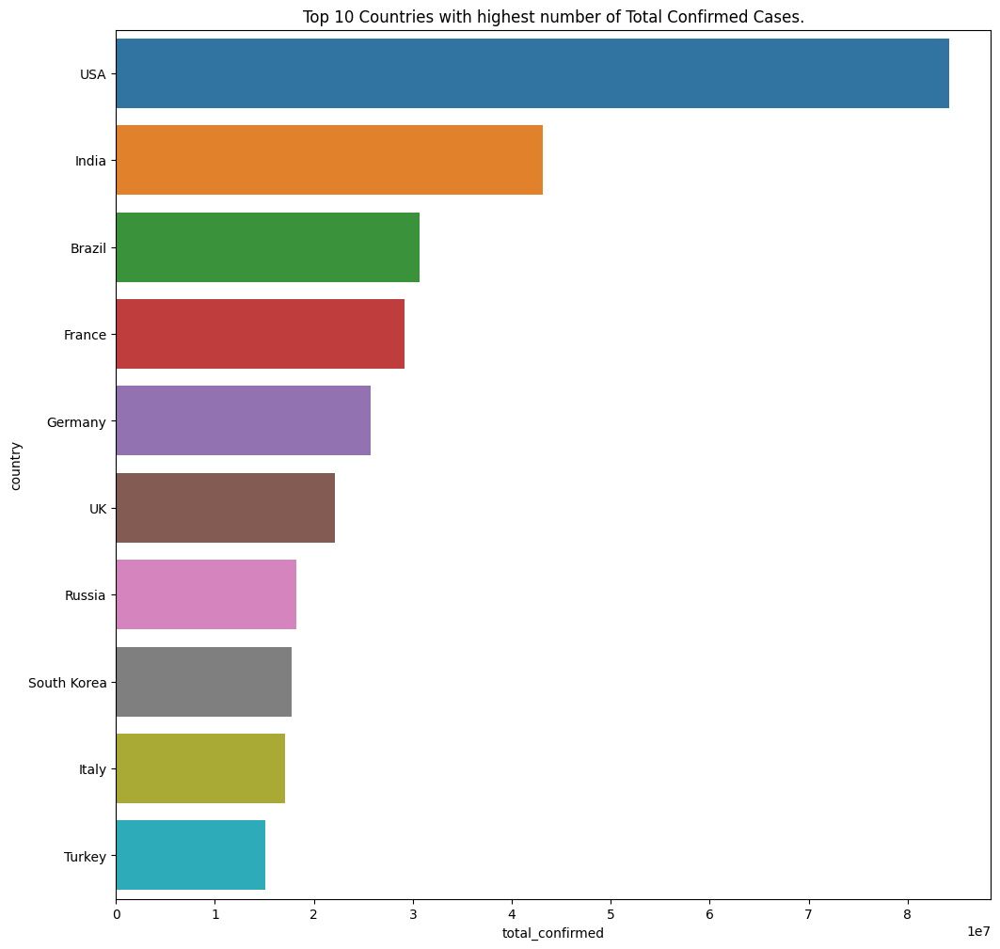

In [49]:
plt.figure(figsize=(12,12))
sns.barplot(x='total_confirmed',
           y='country',data=Top_10_Confirmed_Cases)
plt.title("Top 10 Countries with highest number of Total Confirmed Cases.")
plt.show()

## [4.2 Top 10 Countries with highest number of Serious Critical Cases.](#section402)

In [50]:
Top_10_Serious_Critical_Cases=Corona_Virus_Summary.sort_values('serious_or_critical',ascending=False).head(10)
Top_10_Serious_Critical_Cases

,country,continent,total_confirmed,total_deaths,total_recovered,active_cases,serious_or_critical,total_cases_per_1m_population,total_deaths_per_1m_population,total_tests,total_tests_per_1m_population,population,positive_rate
26,Brazil,South America,30682094,664920.0,29718402.0,298772.0,8318.0,142460,3087.0,6.377617e+07,296119.0,215373503,48.109029
131,Mexico,North America,5745652,324465.0,5044893.0,376294.0,4798.0,43708,2468.0,1.585549e+07,120615.0,131455607,36.237619
95,Indonesia,Asia,6050776,156458.0,5889534.0,4784.0,2771.0,21694,561.0,9.724539e+07,348662.0,278910317,6.222173
165,Russia,Europe,18260293,377670.0,17647179.0,235444.0,2300.0,125027,2586.0,2.734000e+08,1871949.0,146050996,6.678966
216,USA,North America,84209473,1026646.0,81244260.0,1938567.0,1941.0,251659,3068.0,1.016883e+09,3038939.0,334617623,8.281141
203,Thailand,Asia,4373846,29475.0,4273599.0,70772.0,1496.0,62371,420.0,1.727078e+07,246281.0,70126166,25.325129
72,France,Europe,29160802,147257.0,28156674.0,856871.0,1329.0,444914,2247.0,2.714902e+08,4142201.0,65542502,10.741015
78,Germany,Europe,25780226,137919.0,23956700.0,1685607.0,1279.0,305877,1636.0,1.223324e+08,1451450.0,84282880,21.073918
15,Bangladesh,Asia,1953012,29127.0,1899419.0,24466.0,1273.0,11643,174.0,1.405146e+07,83767.0,167745162,13.899002
0,Afghanistan,Asia,179267,7690.0,162202.0,9375.0,1124.0,4420,190.0,9.513370e+05,23455.0,40560636,18.843691


In [51]:
Corona_Virus_Summary[['country','serious_or_critical']].sort_values(by='serious_or_critical',ascending=False).head(10)

,country,serious_or_critical
26,Brazil,8318.0
131,Mexico,4798.0
95,Indonesia,2771.0
165,Russia,2300.0
216,USA,1941.0
203,Thailand,1496.0
72,France,1329.0
78,Germany,1279.0
15,Bangladesh,1273.0
0,Afghanistan,1124.0


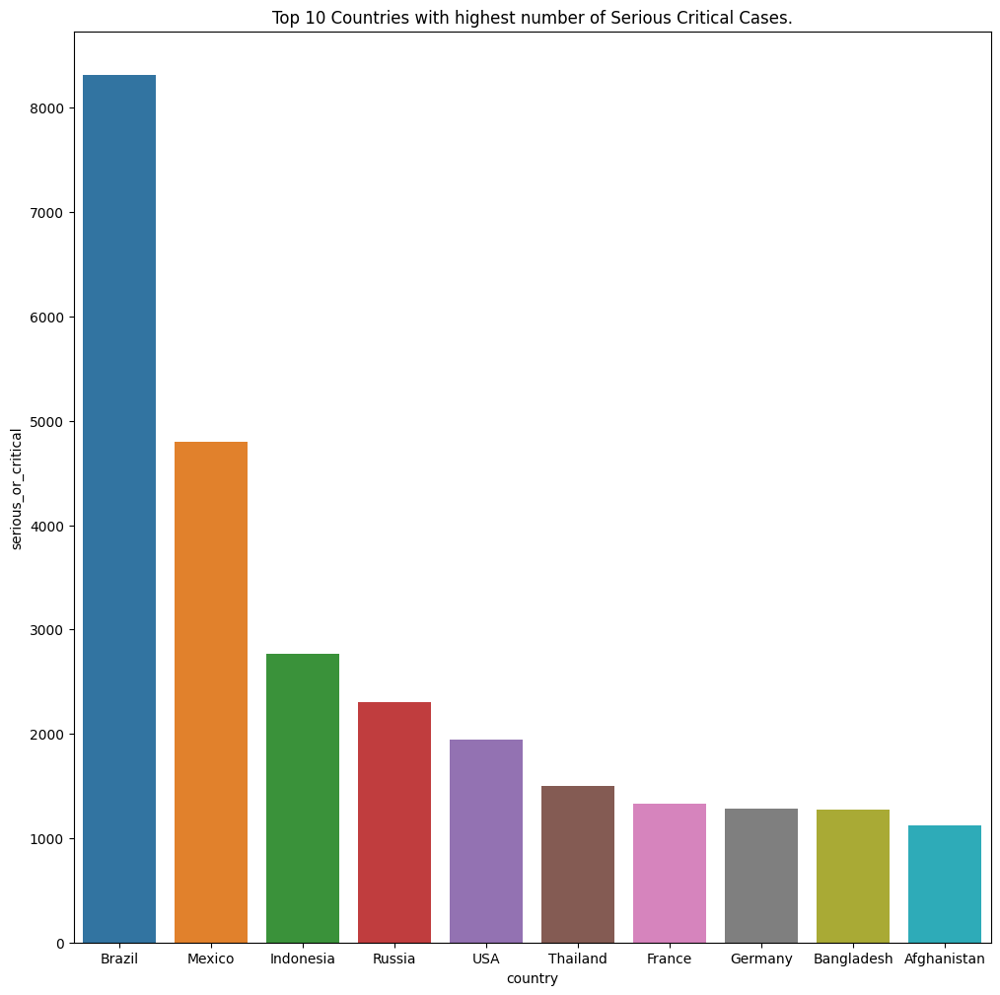

In [52]:
plt.figure(figsize=(12,12))
sns.barplot(x='country',
           y='serious_or_critical',data=Top_10_Serious_Critical_Cases)
plt.title("Top 10 Countries with highest number of Serious Critical Cases.")
plt.show()

1. **Brazil** has the **highest** number of Serious or Critical Case.
2. **Mexico** has the **second**  highest number of  Seriours or Critical Case.
3. **Indonesia** has the **third** highest number of  Seriours or Critical Case

 ## [4.3 Top 10 countries with Total Covid-19 Deaths.](#section403)

In [53]:
Top_10_Total_Deaths=Corona_Virus_Summary.sort_values('total_deaths',ascending=False).head(10)
Top_10_Total_Deaths

,country,continent,total_confirmed,total_deaths,total_recovered,active_cases,serious_or_critical,total_cases_per_1m_population,total_deaths_per_1m_population,total_tests,total_tests_per_1m_population,population,positive_rate
216,USA,North America,84209473,1026646.0,81244260.0,1938567.0,1941.0,251659,3068.0,1.016883e+09,3038939.0,334617623,8.281141
26,Brazil,South America,30682094,664920.0,29718402.0,298772.0,8318.0,142460,3087.0,6.377617e+07,296119.0,215373503,48.109029
94,India,Asia,43121599,524214.0,42579693.0,17692.0,698.0,30686,373.0,8.438369e+08,600479.0,1405273033,5.110182
165,Russia,Europe,18260293,377670.0,17647179.0,235444.0,2300.0,125027,2586.0,2.734000e+08,1871949.0,146050996,6.678966
131,Mexico,North America,5745652,324465.0,5044893.0,376294.0,4798.0,43708,2468.0,1.585549e+07,120615.0,131455607,36.237619
158,Peru,South America,3571919,213023.0,0.0,0.0,248.0,105593,6297.0,3.022687e+07,893567.0,33827210,11.817033
212,UK,Europe,22159805,176708.0,21677896.0,305201.0,253.0,323264,2578.0,5.192641e+08,7574950.0,68550166,4.267540
101,Italy,Europe,17057873,165244.0,15894511.0,998118.0,347.0,282901,2741.0,2.178537e+08,3613054.0,60296265,7.829968
95,Indonesia,Asia,6050776,156458.0,5889534.0,4784.0,2771.0,21694,561.0,9.724539e+07,348662.0,278910317,6.222173
72,France,Europe,29160802,147257.0,28156674.0,856871.0,1329.0,444914,2247.0,2.714902e+08,4142201.0,65542502,10.741015


In [54]:
Corona_Virus_Summary[['country','total_deaths']].sort_values(by='total_deaths',ascending=False).head(10)

,country,total_deaths
216,USA,1026646.0
26,Brazil,664920.0
94,India,524214.0
165,Russia,377670.0
131,Mexico,324465.0
158,Peru,213023.0
212,UK,176708.0
101,Italy,165244.0
95,Indonesia,156458.0
72,France,147257.0


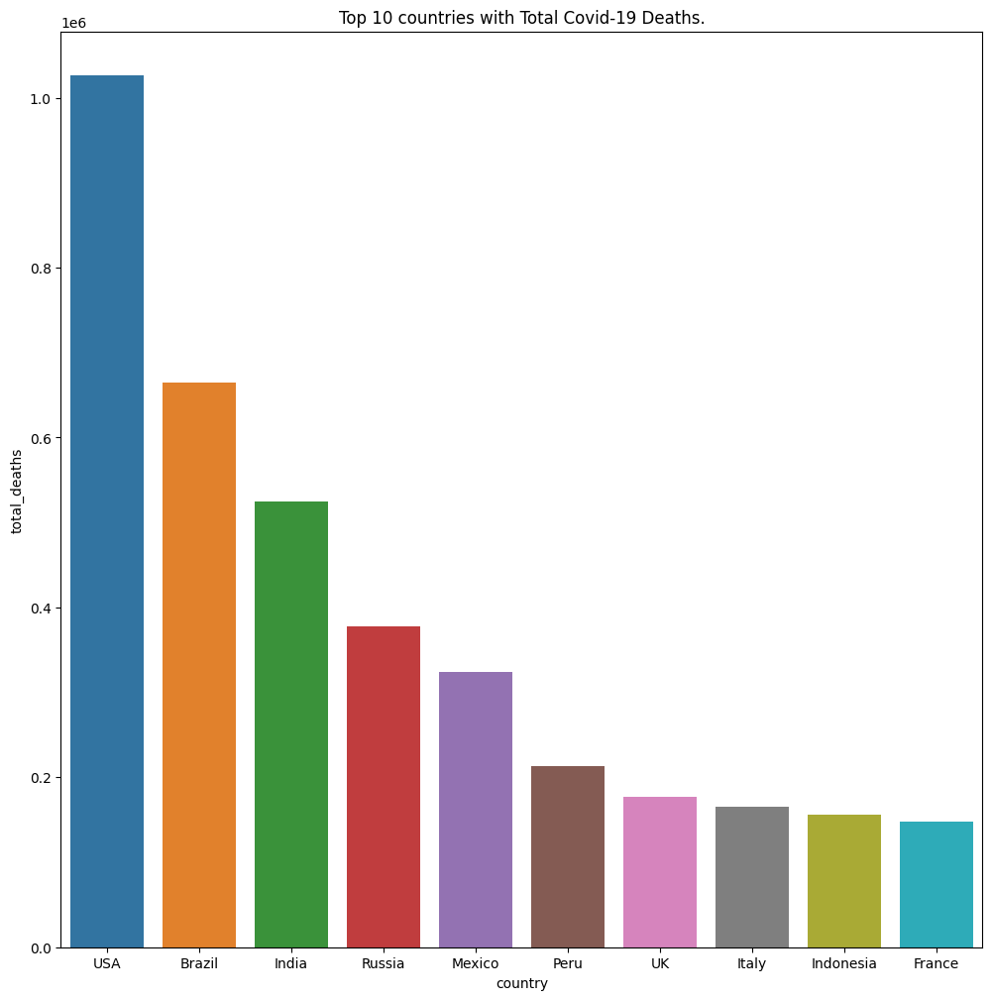

In [55]:
plt.figure(figsize=(12,12))
sns.barplot(x='country',
           y='total_deaths',data=Top_10_Total_Deaths)
plt.title("Top 10 countries with Total Covid-19 Deaths.")
plt.show()

1. **USA** has the **highest** number of Serious or Critical Case.
2. **Brazil** has the **second**  highest number of  Seriours or Critical Case.
3. **India** has the **third** highest number of  Seriours or Critical Case

## [4.4 Total Recovered Cases Vs Active Cases Vs Total Death Cases.](#section404)

In [56]:
data_df=Corona_Virus_Summary[['country','total_recovered','active_cases','total_deaths']]
data_df

,country,total_recovered,active_cases,total_deaths
0,Afghanistan,162202.0,9375.0,7690.0
1,Albania,271826.0,251.0,3497.0
2,Algeria,178371.0,80570.0,6875.0
3,Andorra,41021.0,982.0,153.0
4,Angola,97149.0,145.0,1900.0
...,...,...,...,...
221,Wallis And Futuna Islands,438.0,9.0,7.0
222,Western Sahara,9.0,0.0,1.0
223,Yemen,9009.0,661.0,2149.0
224,Zambia,315997.0,611.0,3983.0


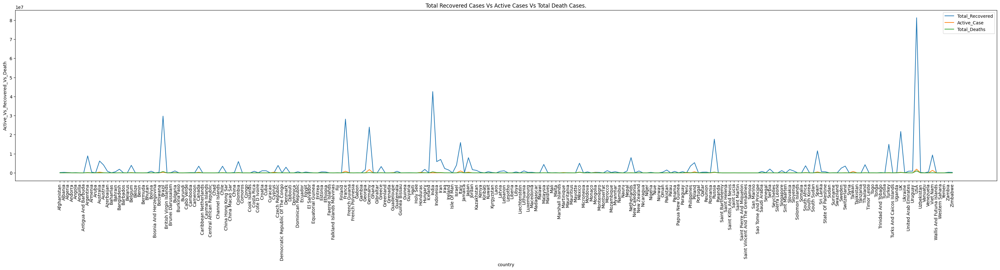

In [57]:
plt.figure(figsize=(40,7))
sns.lineplot(x='country',y='total_recovered',data=data_df,label="Total_Recovered")
sns.lineplot(x='country',y='active_cases',data=data_df,label="Active_Case")
sns.lineplot(x='country',y='total_deaths',data=data_df,label="Total_Deaths")
plt.xticks(rotation=90)
plt.ylabel("Active_Vs_Recovered_Vs_Death")
plt.title("Total Recovered Cases Vs Active Cases Vs Total Death Cases.")
plt.legend()
plt.show()

In [58]:
data_df[['country','total_deaths']].sort_values(by="total_deaths" ,ascending=False)

,country,total_deaths
216,USA,1026646.0
26,Brazil,664920.0
94,India,524214.0
165,Russia,377670.0
131,Mexico,324465.0
...,...,...
142,Nauru,0.0
69,Falkland Islands Malvinas,0.0
150,Niue,0.0
168,Saint Helena,0.0


In [59]:
data_df[['country','total_deaths']].sort_values(by="total_deaths" ,ascending=False)

,country,total_deaths
216,USA,1026646.0
26,Brazil,664920.0
94,India,524214.0
165,Russia,377670.0
131,Mexico,324465.0
...,...,...
142,Nauru,0.0
69,Falkland Islands Malvinas,0.0
150,Niue,0.0
168,Saint Helena,0.0


In [60]:
data_df[['country','active_cases']].sort_values(by="active_cases" ,ascending=False)

,country,active_cases
216,USA,1938567.0
78,Germany,1685607.0
220,Viet Nam,1298525.0
101,Italy,998118.0
72,France,856871.0
...,...,...
43,China Macao Sar,0.0
194,Sudan,0.0
17,Belarus,0.0
110,Laos,0.0


1.US ,Germany and Viet Nam has large number of Active case

2.US,India  and Brizil  hs largest number of Recovered case

3.US,Brizil and India has largest number of Deaths case

## [4.5  Types of Vaccines in use](#section405)

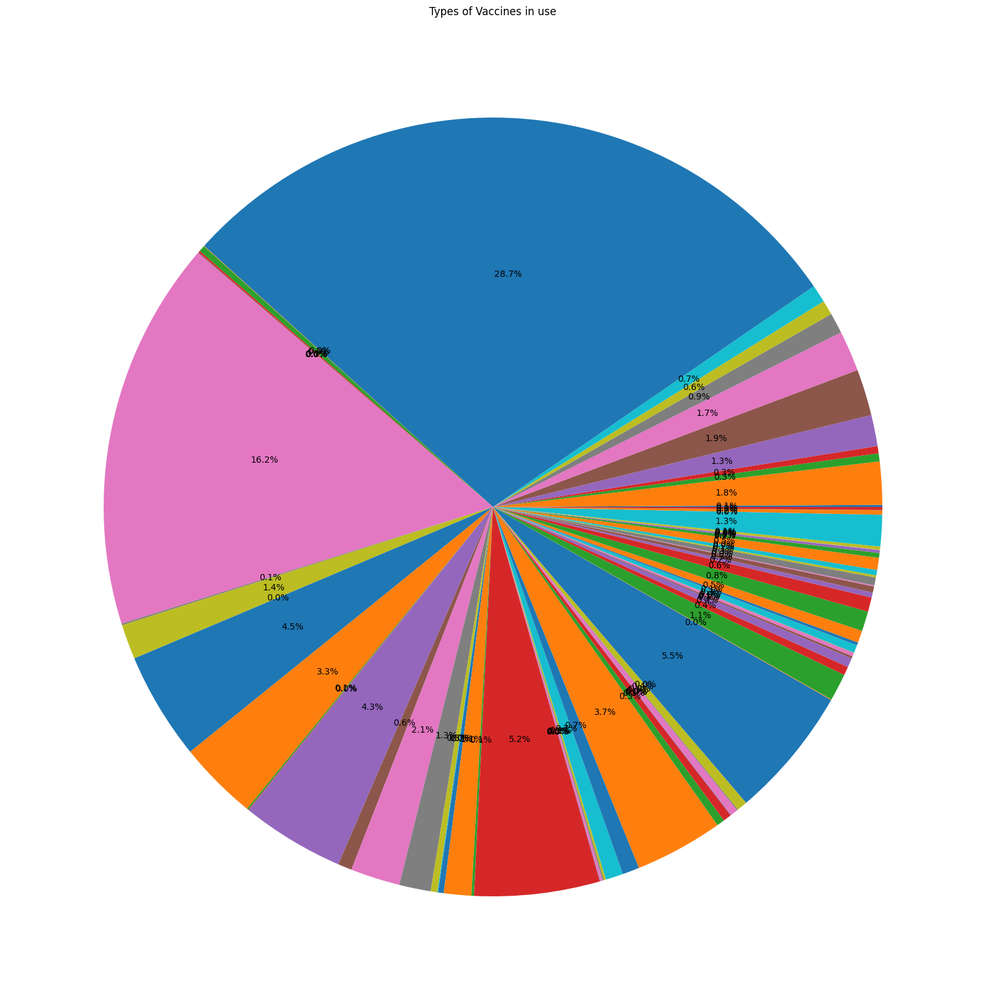

In [61]:
plt.figure(figsize=(40,20))
data_df=Vaccinations.groupby('vaccines')['daily_vaccinations'].sum()
plt.title("Types of Vaccines in use")
plt.pie(data_df,autopct='%1.1f%%');

In [62]:
Vaccinations.groupby('vaccines')['daily_vaccinations'].count().sort_values(ascending=False)

vaccines
Johnson&Johnson, Moderna, Oxford/AstraZeneca, Pfizer/BioNTech                     7608
Moderna, Oxford/AstraZeneca, Pfizer/BioNTech                                      6263
Oxford/AstraZeneca                                                                6022
Oxford/AstraZeneca, Pfizer/BioNTech                                               4629
Johnson&Johnson, Moderna, Novavax, Oxford/AstraZeneca, Pfizer/BioNTech            3564
                                                                                  ... 
Johnson&Johnson, Oxford/AstraZeneca, Sinovac                                       312
Moderna, Oxford/AstraZeneca, Pfizer/BioNTech, Sinovac, Sputnik V                   311
Johnson&Johnson, Moderna                                                           251
Johnson&Johnson, Pfizer/BioNTech, Sinopharm/Beijing                                228
EpiVacCorona, Oxford/AstraZeneca, QazVac, Sinopharm/Beijing, Sputnik V, ZF2001     190
Name: daily_vaccinations, Length: 

In [63]:
dataset=Vaccinations['vaccines'].unique()
dataset

array(['Johnson&Johnson, Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm/Beijing',
       'Oxford/AstraZeneca, Pfizer/BioNTech, Sinovac, Sputnik V',
       'Oxford/AstraZeneca, Sinopharm/Beijing, Sinovac, Sputnik V',
       'Moderna, Oxford/AstraZeneca, Pfizer/BioNTech',
       'Oxford/AstraZeneca', 'Oxford/AstraZeneca, Pfizer/BioNTech',
       'Oxford/AstraZeneca, Pfizer/BioNTech, Sputnik V',
       'CanSino, Moderna, Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm/Beijing, Sputnik V',
       'Moderna, Oxford/AstraZeneca, Sinopharm/Beijing, Sinovac, Sputnik V',
       'Pfizer/BioNTech',
       'Johnson&Johnson, Moderna, Novavax, Oxford/AstraZeneca, Pfizer/BioNTech',
       'Johnson&Johnson, Oxford/AstraZeneca, Pfizer/BioNTech',
       'Johnson&Johnson, Moderna, Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm/Beijing, Sputnik Light, Sputnik V',
       'Johnson&Johnson, Moderna, Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm/Beijing, Sinovac',
       'Oxford/AstraZeneca, Pfizer/BioNTech, S

In [64]:
Types_of_Vaccines=[]

for i in dataset:
    j=i.split(",")
    for s in j:
        if s.strip(" ") not in Types_of_Vaccines:
            Types_of_Vaccines.append(s.strip(" "))
Types_of_Vaccines
print("There are ",len(Types_of_Vaccines)," types of Vaccines in use:")
print(Types_of_Vaccines)

There are  24  types of Vaccines in use:
['Johnson&Johnson', 'Oxford/AstraZeneca', 'Pfizer/BioNTech', 'Sinopharm/Beijing', 'Sinovac', 'Sputnik V', 'Moderna', 'CanSino', 'Novavax', 'Sputnik Light', 'Covaxin', 'Sinopharm/Wuhan', 'ZF2001', 'Abdala', 'Soberana Plus', 'Soberana02', 'COVIran Barekat', 'FAKHRAVAC', 'Razi Cov Pars', 'SpikoGen', 'QazVac', 'EpiVacCorona', 'Medigen', 'Turkovac']


In [65]:
Types_of_Vaccines=[]
for i in dataset:
    j=i.split(",")
    for s in j:
        Types_of_Vaccines.append(s.strip(" "))
set(Types_of_Vaccines)

{'Abdala',
 'COVIran Barekat',
 'CanSino',
 'Covaxin',
 'EpiVacCorona',
 'FAKHRAVAC',
 'Johnson&Johnson',
 'Medigen',
 'Moderna',
 'Novavax',
 'Oxford/AstraZeneca',
 'Pfizer/BioNTech',
 'QazVac',
 'Razi Cov Pars',
 'Sinopharm/Beijing',
 'Sinopharm/Wuhan',
 'Sinovac',
 'Soberana Plus',
 'Soberana02',
 'SpikoGen',
 'Sputnik Light',
 'Sputnik V',
 'Turkovac',
 'ZF2001'}

## [ 4.6 Which Set of Vaccines are preferred by which Country?](#section406)

In [66]:
data=Vaccinations.groupby("country")['vaccines'].unique()

In [67]:
pd.DataFrame(data).reset_index()

,country,vaccines
0,Afghanistan,"[Johnson&Johnson, Oxford/AstraZeneca, Pfizer/B..."
1,Albania,"[Oxford/AstraZeneca, Pfizer/BioNTech, Sinovac,..."
2,Algeria,"[Oxford/AstraZeneca, Sinopharm/Beijing, Sinova..."
3,Andorra,"[Moderna, Oxford/AstraZeneca, Pfizer/BioNTech]"
4,Angola,[Oxford/AstraZeneca]
...,...,...
218,Wales,"[Moderna, Oxford/AstraZeneca, Pfizer/BioNTech]"
219,Wallis and Futuna,[Moderna]
220,Yemen,"[Johnson&Johnson, Oxford/AstraZeneca, Sinovac]"
221,Zambia,"[Johnson&Johnson, Oxford/AstraZeneca, Sinophar..."


## [4.7 What is the Trend of Vaccinations Country Wise?](#section407)

In [68]:
data=Vaccinations.groupby("country")[['daily_vaccinations']].sum()
data_df=pd.DataFrame(data).reset_index()

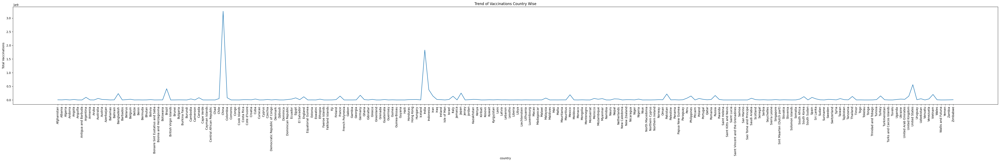

In [69]:
plt.figure(figsize=(60,6))

sns.lineplot(x='country',y='daily_vaccinations',data=data_df)
plt.xticks(rotation = 90)
plt.ylabel("Total Vaccinations")
plt.title('Trend of Vaccinations Country Wise')
plt.show()

 ## [4.9 What is Country Wise Positive Rate?](#section409)

In [70]:
Top_10=Corona_Virus_Summary.sort_values(by='positive_rate',ascending=False).head(10)

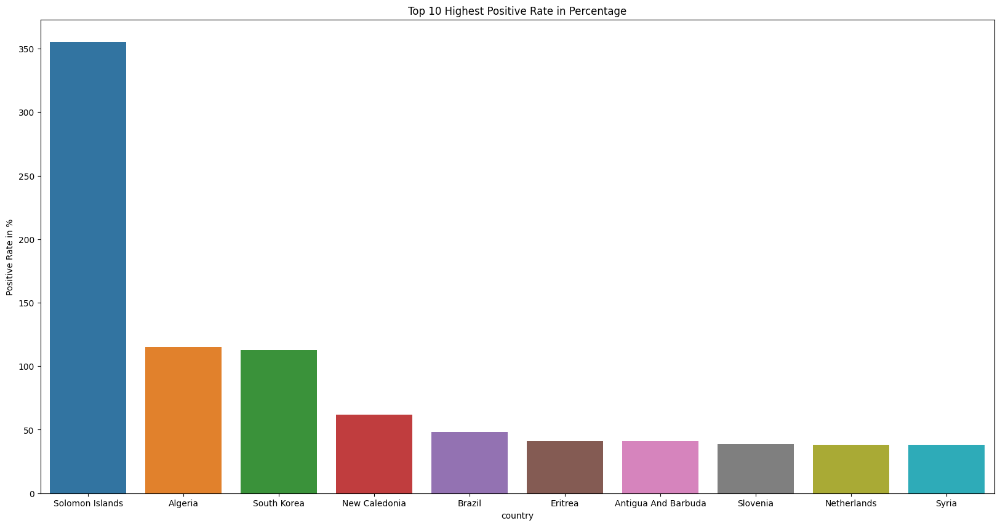

In [71]:
plt.figure(figsize=(20,10))
sns.barplot(x='country',y='positive_rate',data=Top_10)
plt.ylabel("Positive Rate in %")
plt.title("Top 10 Highest Positive Rate in Percentage")
plt.show()

1.Solomon Islands has the highest positive rate

2.Algeria is the Second highest Positive rate

3.South Korea has the third highest positive rate